# Segmentez des clients d'un site e-commerce

# Notebook de l'analyse exploratoire

# SALMA CHAFAI

**Sujet :**

Vous êtes consultant pour Olist, une entreprise brésilienne qui propose une solution de vente sur les marketplaces en ligne.

Olist souhaite que vous fournissiez à ses équipes d'e-commerce une segmentation des clients qu’elles pourront utiliser au quotidien pour leurs campagnes de communication.

Votre objectif est de comprendre les différents types d’utilisateurs grâce à leur comportement et à leurs données personnelles.

Vous devrez fournir à l’équipe marketing une description actionable de votre segmentation et de sa logique sous-jacente pour une utilisation optimale, ainsi qu’une proposition de contrat de maintenance basée sur une analyse de la stabilité des segments au cours du temps.

## A) Importation des bibliothèques essentiels

### 1- Les bibliothèques usuelles et les bibliothèques de visualisation

In [1]:
 # ça nous permet d'importer numpy avec son nom np et matplotlib.pyplot as plt
%pylab inline 

# data
import pandas as pd
import numpy as np
import scipy 

# visualisation
import seaborn as sns
import missingno as msn
import matplotlib.pyplot as plt

# Librairie plotly pour les graphiques intéractives
import plotly.graph_objects as go
import plotly as plo
import plotly.express as px
from plotly.offline import download_plotlyjs, init_notebook_mode,iplot
from plotly.subplots import make_subplots

# Imputation
from sklearn.experimental import enable_iterative_imputer
from sklearn.impute import KNNImputer
from sklearn.impute import SimpleImputer
from sklearn.impute import IterativeImputer

#outliers
from sklearn.ensemble import IsolationForest

Populating the interactive namespace from numpy and matplotlib


## B) Les jeux de données

### 1- Les 9 jeux de données

#### (a) Affichage des 9 jeux de données et leurs tailles

In [2]:
pd.set_option('display.max_columns', None)
# Le jeu de données des clients
customers = pd.read_csv("C:/Users/admteliae/Desktop/Formatio_OC_temporaire/Projet 5/Data/olist_customers_dataset.csv", sep=',')

# Le jeu de données de la geolocation 
geolocation = pd.read_csv("C:/Users/admteliae/Desktop/Formatio_OC_temporaire/Projet 5/Data/olist_geolocation_dataset.csv", sep=',')

# Le jeu de données des éléments des commandes 
orders_items = pd.read_csv("C:/Users/admteliae/Desktop/Formatio_OC_temporaire/Projet 5/Data/olist_order_items_dataset.csv", sep=',')

# Le jeu de données des paiements des commandes
orders_pay = pd.read_csv("C:/Users/admteliae/Desktop/Formatio_OC_temporaire/Projet 5/Data/olist_order_payments_dataset.csv", sep=',')

# Le jeu de données des commentaires sur les commandes
orders_reviews = pd.read_csv("C:/Users/admteliae/Desktop/Formatio_OC_temporaire/Projet 5/Data/olist_order_reviews_dataset.csv", sep=',')

# Le jeu de données des commandes
orders = pd.read_csv("C:/Users/admteliae/Desktop/Formatio_OC_temporaire/Projet 5/Data/olist_orders_dataset.csv", sep=',')

# Le jeu de données des produits
products = pd.read_csv("C:/Users/admteliae/Desktop/Formatio_OC_temporaire/Projet 5/Data/olist_products_dataset.csv", sep=',')

# Le jeu de données des vendeurs
sellers = pd.read_csv("C:/Users/admteliae/Desktop/Formatio_OC_temporaire/Projet 5/Data/olist_sellers_dataset.csv", sep=',')

# Le jeu de données des catégories des produits traduits en anglais
catprod = pd.read_csv("C:/Users/admteliae/Desktop/Formatio_OC_temporaire/Projet 5/Data/product_category_name_translation.csv", sep=',')

In [3]:
# Un dictionnaire qui contients le noms et les jeux de données
dict_data = {'Data customers' : customers,
             'Data geolocation' : geolocation,
             'Data orders_items' : orders_items,
             'Data orders_pay' : orders_pay, 
             'Data orders_reviews' : orders_reviews,
             'Data orders' : orders,
             'Data products' : products, 
             'Data sellers' : sellers, 
             'Data category_products' : catprod}

In [4]:
# Affichage des 5 premières lignes des jeux de données (A revoir l'affichage)
for name, data in dict_data.items() :
    print(f"Le jeu de données {name} : \n\n {data.head()}")
    print('-'*100)

Le jeu de données Data customers : 

                         customer_id                customer_unique_id  \
0  06b8999e2fba1a1fbc88172c00ba8bc7  861eff4711a542e4b93843c6dd7febb0   
1  18955e83d337fd6b2def6b18a428ac77  290c77bc529b7ac935b93aa66c333dc3   
2  4e7b3e00288586ebd08712fdd0374a03  060e732b5b29e8181a18229c7b0b2b5e   
3  b2b6027bc5c5109e529d4dc6358b12c3  259dac757896d24d7702b9acbbff3f3c   
4  4f2d8ab171c80ec8364f7c12e35b23ad  345ecd01c38d18a9036ed96c73b8d066   

   customer_zip_code_prefix          customer_city customer_state  
0                     14409                 franca             SP  
1                      9790  sao bernardo do campo             SP  
2                      1151              sao paulo             SP  
3                      8775        mogi das cruzes             SP  
4                     13056               campinas             SP  
----------------------------------------------------------------------------------------------------
Le jeu de donn

In [5]:
# Taille de chaque jeu de données 
for name, data in dict_data.items() :
    print(f"La taille du jeu de données {name} : {data.shape}")

La taille du jeu de données Data customers : (99441, 5)
La taille du jeu de données Data geolocation : (1000163, 5)
La taille du jeu de données Data orders_items : (112650, 7)
La taille du jeu de données Data orders_pay : (103886, 5)
La taille du jeu de données Data orders_reviews : (99224, 7)
La taille du jeu de données Data orders : (99441, 8)
La taille du jeu de données Data products : (32951, 9)
La taille du jeu de données Data sellers : (3095, 4)
La taille du jeu de données Data category_products : (71, 2)


In [6]:
# Info sur chaque jeu de données 
for name, data in dict_data.items() :
    print(f"Les infos du jeu de données {name} :")
    data.info()
    print('-'*100)

Les infos du jeu de données Data customers :
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 99441 entries, 0 to 99440
Data columns (total 5 columns):
 #   Column                    Non-Null Count  Dtype 
---  ------                    --------------  ----- 
 0   customer_id               99441 non-null  object
 1   customer_unique_id        99441 non-null  object
 2   customer_zip_code_prefix  99441 non-null  int64 
 3   customer_city             99441 non-null  object
 4   customer_state            99441 non-null  object
dtypes: int64(1), object(4)
memory usage: 3.8+ MB
----------------------------------------------------------------------------------------------------
Les infos du jeu de données Data geolocation :
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1000163 entries, 0 to 1000162
Data columns (total 5 columns):
 #   Column                       Non-Null Count    Dtype  
---  ------                       --------------    -----  
 0   geolocation_zip_code_prefix  10001

#### (b) Informations sur les jeux de données et leurs colonnes**

**Le jeu de données customers**

Ce jeu de données contient des informations sur le client et son emplacement. On l'utilisera par la suite pour identifier les clients uniques dans le jeu de données des commandes et pour trouver le lieu de livraison des commandes.

Dans notre système, chaque commande est attribuée à un identifiant client unique. Cela signifie que le même client aura des identifiants différents pour des commandes différentes. Le but d'avoir un customer_unique_id dans l'ensemble de données est de vous permettre d'identifier les clients qui ont fait des réachats au magasin. Sinon, vous constateriez que chaque commande est associée à un client différent. (Chaque commande a un "customer_id" propre à elle (unique). Un client est représenté par son "customer_id_unique". Quand un client effectue plusieurs commandes différentes, on aura "customer_unique_id" qui se répète mais le "customer_id" non comme on peut le voir dans l'image ci-dessus).
   
   - **Définitions des colonnes du dataset** 
     
     - 'customer_id' : La clé de l'ensemble de données des commandes. Chaque commande a un numéro de client unique.
  
     - 'customer_unique_id' : identifiant unique d'un client.

In [7]:
customers[customers['customer_unique_id'] == '8d50f5eadf50201ccdcedfb9e2ac8455'].head()

,customer_id,customer_unique_id,customer_zip_code_prefix,customer_city,customer_state
14186,1bd3585471932167ab72a84955ebefea,8d50f5eadf50201ccdcedfb9e2ac8455,4045,sao paulo,SP
15321,a8fabc805e9a10a3c93ae5bff642b86b,8d50f5eadf50201ccdcedfb9e2ac8455,4045,sao paulo,SP
16654,897b7f72042714efaa64ac306ba0cafc,8d50f5eadf50201ccdcedfb9e2ac8455,4045,sao paulo,SP
36122,b2b13de0770e06de50080fea77c459e6,8d50f5eadf50201ccdcedfb9e2ac8455,4045,sao paulo,SP
38073,42dbc1ad9d560637c9c4c1533746f86d,8d50f5eadf50201ccdcedfb9e2ac8455,4045,sao paulo,SP


**Le jeu de données geolocation**

Ce jeu de données contient des informations sur les codes postaux brésiliens et leurs coordonnées lat/lng. Utilisez-le pour tracer des cartes et trouver les distances entre les vendeurs et les clients.
   
   - **Définitions des colonnes du dataset** 
     
     - 'geolocation_zip_code_prefix' : 5 premiers chiffres du code postal.
  
     - 'geolocation_lat' : la latitude.
     
     - 'geolocation_lng' : la longitude
     
     - 'geolocation_city' : nom de la ville
     
     - 'geolocation_state' : Etat.

**Le jeu de données orders_items**

Cet ensemble de données comprend des données sur les articles achetés dans le cadre de chaque commande.

  - **Définitions des colonnes du dataset** 
      - 'order_id' : identifiant unique de la commande.
  
      - 'order_item_id' : numéro séquentiel identifiant le nombre d'articles inclus dans la même commande.
  
      - 'product_id' : identifiant unique du produit.
  
      - 'seller_id' : identifiant unique du vendeur.
  
      - 'shipping_limit_date' : Indique la date limite d'expédition du vendeur pour le transfert de la commande au partenaire logistique.
  
      - 'freight_value' : article valeur du fret article (si une commande comporte plus d'un article, la valeur du fret est répartie entre les articles)

**Le jeu de données orders_payments**

Cet ensemble de données comprend des données sur les options de paiement des commandes.

  - **Définitions des colonnes du dataset** 
      - 'order_id' : identifiant unique de la commande.
  
      - 'payment_sequential' : un client peut payer une commande avec plus d'un mode de paiement. S'il le fait, une séquence sera créée pour.
  
      - 'payment_type' : le mode de paiement choisi par le client.
  
      - 'payment_installments' : nombre de versements choisis par le client.
  
      - 'payment_value' : valeur de la transaction.

**Le jeu de données orders_reviews**

Cet ensemble de données comprend des données sur les évaluations faites par les clients.

Lorsqu'un client achète un produit sur Olist Store, le vendeur est informé qu'il doit exécuter la commande. Une fois que le client a reçu le produit, ou que la date de livraison estimée est arrivée, le client reçoit une enquête de satisfaction par e-mail où il peut donner une note sur l'expérience d'achat et écrire quelques commentaires.

  - **Définitions des colonnes du dataset** 
      - 'review_id' : identifiant unique de l'évaluation.

      - 'order_id' : identifiant unique de la commande.

      - 'review_score' : Note allant de 1 à 5 donnée par le client dans une enquête de satisfaction.

      - 'review_comment_title' : Titre du commentaire laissé par le client, en portugais.

      - 'review_comment_message' : Message de commentaire de l'avis laissé par le client, en portugais.

      - 'review_creation_date' : Indique la date à laquelle l'enquête de satisfaction a été envoyée au client.

      - 'review_answer_timestamp' : Indique l'horodatage de la réponse à l'enquête de satisfaction.

**Le jeu de données orders**

Cet ensemble de données comprend des données sur les articles achetés dans le cadre de chaque commande.

  - **Définitions des colonnes du dataset** 
      - 'customer_id' : La clé de l'ensemble de données sur les clients. Chaque commande a un identifiant client unique.

      - 'order_id' : identifiant unique de la commande.

      - 'order_status' : Référence au statut de la commande (livrée, expédiée, etc.).

      - 'order_purchase_timestamp' : Indique l'horodatage de l'achat.

      - 'order_approved_at' : Indique l'horodatage de l'approbation du paiement.

      - 'order_delivered_carrier_date' : Indique l'horodatage de la commande. Il s'agit de la date à laquelle la commande a été traitée par le partenaire logistique.

      - 'order_delivered_customer_date' : Indique la date réelle de livraison de la commande au client.

      - 'order_estimated_delivery_date' : Indique la date de livraison estimée qui a été communiquée au client au moment de l'achat.

**Le jeu de données products**

Ce jeu de données comprend des données sur les produits vendus par Olist.

  - **Définitions des colonnes du dataset** 
      - 'product_id' : identifiant unique du produit

      - 'product_category_name' : Une catégorie de produit, en portugais.

      - 'product_name_lenght' : nombre de caractères extraits du nom du produit.

      - 'product_description_lenght' : nombre de caractères extraits de la description du produit.

      - 'product_photos_qty' : nombre de photos de produits publiées

      - 'product_weight_g' : poids du produit mesuré en grammes.

      - 'product_length_cm' : longueur du produit mesurée en centimètres.

      - 'product_height_cm' : la hauteur du produit mesurée en centimètres.

      - 'product_width_cm' : largeur du produit mesurée en centimètres.

**Le jeu de données sellers**

Ce jeu de données comprend des données sur les vendeurs qui ont exécuté les commandes passées sur Olist. Utilisez-le pour trouver l'emplacement du vendeur et pour identifier le vendeur qui a exécuté chaque produit.

  - **Définitions des colonnes du dataset** 
      - 'seller_id' : identifiant unique du vendeur.

      - 'seller_zip_code_prefix' : les 5 premiers chiffres du code postal du vendeur.

      - 'seller_city' : ville du vendeur.

      - 'seller_state' : État du vendeur.

**Le jeu de données catprod**

Traduit le nom de la catégorie du produit en anglais.

  - **Définitions des colonnes du dataset** 
      - 'product_category_name' : nom de la catégorie en portugais.
  
      - 'product_category_name_english' : nom de la catégorie en anglais.
  

#### (c) Les valeurs manquantes

In [8]:
# Taux de valeurs manquantes
for name, data in dict_data.items() :
    print(f"Le taux de remplissage du jeu de données {name} : \n\n {(data.isna().sum()/data.shape[0])*100}")
    print('-'*100)

Le taux de remplissage du jeu de données Data customers : 

 customer_id                 0.0
customer_unique_id          0.0
customer_zip_code_prefix    0.0
customer_city               0.0
customer_state              0.0
dtype: float64
----------------------------------------------------------------------------------------------------
Le taux de remplissage du jeu de données Data geolocation : 

 geolocation_zip_code_prefix    0.0
geolocation_lat                0.0
geolocation_lng                0.0
geolocation_city               0.0
geolocation_state              0.0
dtype: float64
----------------------------------------------------------------------------------------------------
Le taux de remplissage du jeu de données Data orders_items : 

 order_id               0.0
order_item_id          0.0
product_id             0.0
seller_id              0.0
shipping_limit_date    0.0
price                  0.0
freight_value          0.0
dtype: float64
-----------------------------------------

#### (d) les doublons

In [9]:
# Les doublons
for name, data in dict_data.items() :
    print(f"Les doublons du jeu de données {name} : {data.duplicated().sum()} doublons")
    print('-'*100)

Les doublons du jeu de données Data customers : 0 doublons
----------------------------------------------------------------------------------------------------
Les doublons du jeu de données Data geolocation : 261831 doublons
----------------------------------------------------------------------------------------------------
Les doublons du jeu de données Data orders_items : 0 doublons
----------------------------------------------------------------------------------------------------
Les doublons du jeu de données Data orders_pay : 0 doublons
----------------------------------------------------------------------------------------------------
Les doublons du jeu de données Data orders_reviews : 0 doublons
----------------------------------------------------------------------------------------------------
Les doublons du jeu de données Data orders : 0 doublons
----------------------------------------------------------------------------------------------------
Les doublons du jeu de donn

On remarque que le jeu de données geolocation contient 261831 doublons (à supprimer par la suite)

In [10]:
def doublons(data):
    """On crée une fonction pour afficher les doublons de chaque colonne du jeu de données
    
    arguments:
    ----------------------
    data : DataFrame : notre jeu de données
    """
    for col in data.columns :
        n = data.duplicated(subset=col).sum()
        print(f"colonne : {col} et le nombre de doublons : {n}")

In [11]:
# Les doublons de chaque colonne du jeu de données
for name, data in dict_data.items() :
    print(f"Les doublons du jeu de données {name} : \n")
    doublons(data)
    print('-'*100)

Les doublons du jeu de données Data customers : 

colonne : customer_id et le nombre de doublons : 0
colonne : customer_unique_id et le nombre de doublons : 3345
colonne : customer_zip_code_prefix et le nombre de doublons : 84447
colonne : customer_city et le nombre de doublons : 95322
colonne : customer_state et le nombre de doublons : 99414
----------------------------------------------------------------------------------------------------
Les doublons du jeu de données Data geolocation : 

colonne : geolocation_zip_code_prefix et le nombre de doublons : 981148
colonne : geolocation_lat et le nombre de doublons : 282803
colonne : geolocation_lng et le nombre de doublons : 282550
colonne : geolocation_city et le nombre de doublons : 992152
colonne : geolocation_state et le nombre de doublons : 1000136
----------------------------------------------------------------------------------------------------
Les doublons du jeu de données Data orders_items : 

colonne : order_id et le nombre 

### 2- Les liens entre les différentes tables

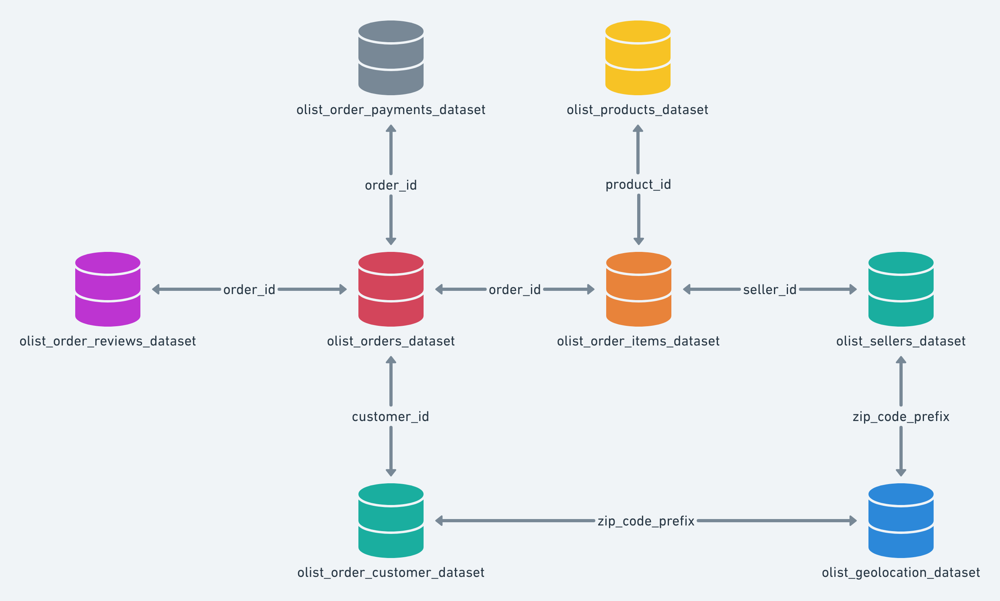

## C) La fusion des données

In [12]:
geolocation_mod = geolocation.drop(columns=['geolocation_city','geolocation_state'],axis=1)

In [13]:
## Fusion des tables

#Merge de la table customers, orders 
df_merge1 = pd.merge(customers, orders, on='customer_id',
                     how='left') 

# Merge avec la table orders_items
df_merge2 = pd.merge(df_merge1, orders_items, on='order_id', how='left')

# Merge avec la table products
df_merge3 = pd.merge(df_merge2, products, on='product_id', how='left')

# Merge avec la table categories products
df_merge4 = pd.merge(df_merge3, catprod, on='product_category_name', how='left')
#df_merge4.drop(columns='product_category_name', axis=1, inplace=True)

# Merge avec la table orders payments 
df_merge5 = pd.merge(df_merge4, orders_pay, on='order_id', how='left')

# Merge avec la table orders reviews
df_merge6 = pd.merge(df_merge5, orders_reviews, on='order_id', how='left')

# Merge avec la table sellers
df_merged = pd.merge(df_merge6, sellers, on='seller_id', how='left')

df_merged.head()

,customer_id,customer_unique_id,customer_zip_code_prefix,customer_city,customer_state,order_id,order_status,order_purchase_timestamp,order_approved_at,order_delivered_carrier_date,order_delivered_customer_date,order_estimated_delivery_date,order_item_id,product_id,seller_id,shipping_limit_date,price,freight_value,product_category_name,product_name_lenght,product_description_lenght,product_photos_qty,product_weight_g,product_length_cm,product_height_cm,product_width_cm,product_category_name_english,payment_sequential,payment_type,payment_installments,payment_value,review_id,review_score,review_comment_title,review_comment_message,review_creation_date,review_answer_timestamp,seller_zip_code_prefix,seller_city,seller_state
0,06b8999e2fba1a1fbc88172c00ba8bc7,861eff4711a542e4b93843c6dd7febb0,14409,franca,SP,00e7ee1b050b8499577073aeb2a297a1,delivered,2017-05-16 15:05:35,2017-05-16 15:22:12,2017-05-23 10:47:57,2017-05-25 10:35:35,2017-06-05 00:00:00,1.0,a9516a079e37a9c9c36b9b78b10169e8,7c67e1448b00f6e969d365cea6b010ab,2017-05-22 15:22:12,124.99,21.88,moveis_escritorio,41.0,1141.0,1.0,8683.0,54.0,64.0,31.0,office_furniture,1.0,credit_card,2.0,146.87,88b8b52d46df026a9d1ad2136a59b30b,4.0,NaN,NaN,2017-05-26 00:00:00,2017-05-30 22:34:40,8577.0,itaquaquecetuba,SP
1,18955e83d337fd6b2def6b18a428ac77,290c77bc529b7ac935b93aa66c333dc3,9790,sao bernardo do campo,SP,29150127e6685892b6eab3eec79f59c7,delivered,2018-01-12 20:48:24,2018-01-12 20:58:32,2018-01-15 17:14:59,2018-01-29 12:41:19,2018-02-06 00:00:00,1.0,4aa6014eceb682077f9dc4bffebc05b0,b8bc237ba3788b23da09c0f1f3a3288c,2018-01-18 20:58:32,289.00,46.48,utilidades_domesticas,43.0,1002.0,3.0,10150.0,89.0,15.0,40.0,housewares,1.0,credit_card,8.0,335.48,02fc48a9efa3e3d0f1a8ea26507eeec3,5.0,NaN,NaN,2018-01-30 00:00:00,2018-02-10 22:43:29,88303.0,itajai,SC
2,4e7b3e00288586ebd08712fdd0374a03,060e732b5b29e8181a18229c7b0b2b5e,1151,sao paulo,SP,b2059ed67ce144a36e2aa97d2c9e9ad2,delivered,2018-05-19 16:07:45,2018-05-20 16:19:10,2018-06-11 14:31:00,2018-06-14 17:58:51,2018-06-13 00:00:00,1.0,bd07b66896d6f1494f5b86251848ced7,7c67e1448b00f6e969d365cea6b010ab,2018-06-05 16:19:10,139.94,17.79,moveis_escritorio,55.0,955.0,1.0,8267.0,52.0,52.0,17.0,office_furniture,1.0,credit_card,7.0,157.73,5ad6695d76ee186dc473c42706984d87,5.0,NaN,NaN,2018-06-15 00:00:00,2018-06-15 12:10:59,8577.0,itaquaquecetuba,SP
3,b2b6027bc5c5109e529d4dc6358b12c3,259dac757896d24d7702b9acbbff3f3c,8775,mogi das cruzes,SP,951670f92359f4fe4a63112aa7306eba,delivered,2018-03-13 16:06:38,2018-03-13 17:29:19,2018-03-27 23:22:42,2018-03-28 16:04:25,2018-04-10 00:00:00,1.0,a5647c44af977b148e0a3a4751a09e2e,7c67e1448b00f6e969d365cea6b010ab,2018-03-27 16:31:16,149.94,23.36,moveis_escritorio,48.0,1066.0,1.0,12160.0,56.0,51.0,28.0,office_furniture,1.0,credit_card,1.0,173.30,059a801bb31f6aab2266e672cab87bc5,5.0,NaN,NaN,2018-03-29 00:00:00,2018-04-02 18:36:47,8577.0,itaquaquecetuba,SP
4,4f2d8ab171c80ec8364f7c12e35b23ad,345ecd01c38d18a9036ed96c73b8d066,13056,campinas,SP,6b7d50bd145f6fc7f33cebabd7e49d0f,delivered,2018-07-29 09:51:30,2018-07-29 10:10:09,2018-07-30 15:16:00,2018-08-09 20:55:48,2018-08-15 00:00:00,1.0,9391a573abe00141c56e38d84d7d5b3b,4a3ca9315b744ce9f8e9374361493884,2018-07-31 10:10:09,230.00,22.25,casa_conforto,61.0,407.0,1.0,5200.0,45.0,15.0,35.0,home_confort,1.0,credit_card,8.0,252.25,8490879d58d6c5d7773f2739a03f089a,5.0,a melhor nota,O baratheon è esxelente Amo adoro o baratheon,2018-08-10 00:00:00,2018-08-17 01:59:52,14940.0,ibitinga,SP


In [14]:
# Taille de la table après fusion
df_merged.shape

(119143, 40)

## D) Nettoyage et exploration

### 1- La variable 'order_status'

<AxesSubplot:ylabel='order_status'>

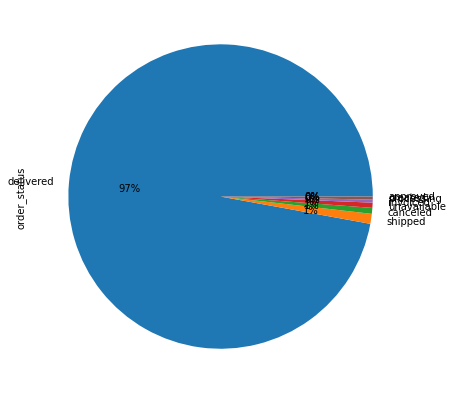

In [15]:
plt.figure(figsize=(10,7))
df_merged['order_status'].value_counts().plot(kind='pie', autopct='%1.0f%%')

On voit qu'on a 97% des commandes qui sont livrées qu'on va gardé par la suite.

### 2- Filtrage

In [16]:
# On garde que les commandes livrées
df_merged_filtre1 = df_merged[df_merged['order_status'] == 'delivered']
df_merged_filtre1.shape

(115723, 40)

In [17]:
# Dans ce cas, on a le même client qui commande la même commande et mets plusieurs commentaires
df_merged_filtre1[df_merged_filtre1.duplicated(subset=['customer_unique_id','order_id','review_id'])][['customer_unique_id','order_id','review_id','review_score']]

,customer_unique_id,order_id,review_id,review_score
19,7f3a72e8f988c6e735ba118d54f47458,17825f24877a9289214c301ae0c9424b,NaN,NaN
23,a96d5cfa0d3181817e2b946f921ea021,aaff8afa47c8426e414a6d908a97713c,7ed1089c451484fd5e7ee0a4036af90d,1.0
24,a96d5cfa0d3181817e2b946f921ea021,aaff8afa47c8426e414a6d908a97713c,7ed1089c451484fd5e7ee0a4036af90d,1.0
37,e079b18794454de9d2be5c12b4392294,77b062be7c5bd21712905feb8e1cfeed,e8ef5d522e155003ba1ff654bdd3d88f,5.0
39,ef07ba9aa5226f77264ffa5762b2280b,a9119eb77d6200811953803a7b6539e1,cd061bfa6e03dfb627117779e74ad9ad,5.0
...,...,...,...,...
119116,b96d6a178adbabf269fd843b37327798,357b4b724bbf34f1d64b1c5dfdc88120,85022c2e590344447d0c852ca92802e3,5.0
119125,4452b8ef472646c4cc042cb31a291f3b,e86b1b2dd48839d7351406434afb578d,75dcc8635930dd09103505944e12451a,4.0
119126,4452b8ef472646c4cc042cb31a291f3b,e86b1b2dd48839d7351406434afb578d,75dcc8635930dd09103505944e12451a,4.0
119130,82d46759af0369aad49084bacf85a6c3,51c6d2f460589fa7b65f2da51e860206,603f2873842a6975a43c54d305397d69,1.0


In [18]:
# La somme de ces lignes redondantes
df_merged_filtre1.duplicated(subset=['customer_unique_id','order_id','review_id','review_score'], keep='first').sum()

18716

In [19]:
# suppression des commandes avec le même cutomer_id, la même commande et le même review_score
df_merged_filtre2 = df_merged_filtre1.drop_duplicates(subset=['customer_unique_id','order_id','review_id'])
df_merged_filtre2.shape

(97007, 40)

<AxesSubplot:>

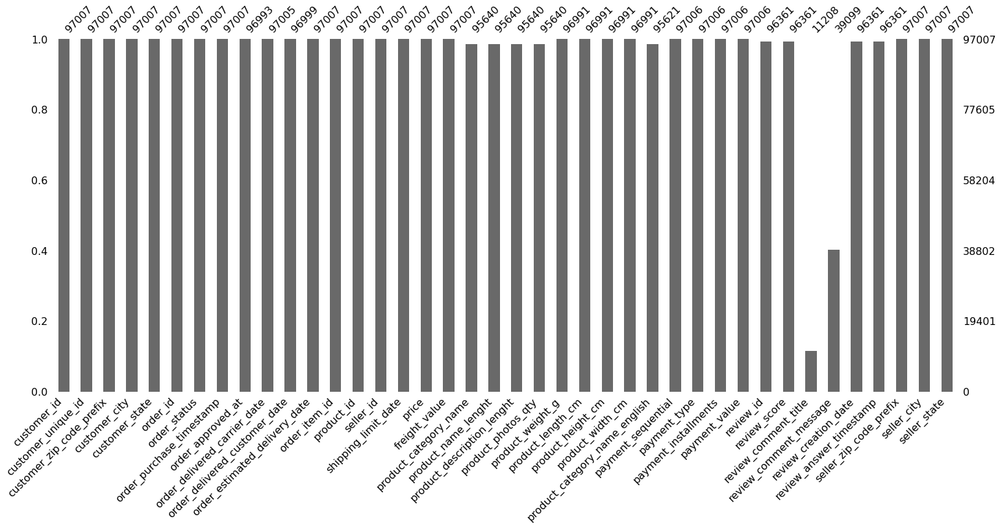

In [20]:
# Taux de remplissage
msn.bar(df_merged_filtre2)

### 3- Suppression des colonnes vides et inutiles

In [21]:
# On supprime les colonnes avec un taux de remplissage faible et les colonnes inutiles pour notre problématique
df_merged_nett1 = df_merged_filtre2.drop(columns=['order_status','product_category_name','product_name_lenght', 
                                                  'product_description_lenght','product_photos_qty','product_weight_g', 
                                                  'product_length_cm','product_height_cm', 'product_width_cm',
                                                  'review_comment_title','review_comment_message','review_creation_date',
                                                  'review_answer_timestamp'])
df_merged_nett1.shape

(97007, 27)

### 4- Suppression des valeurs manquantes

In [22]:
df_merged_nett1.isna().sum()

customer_id                         0
customer_unique_id                  0
customer_zip_code_prefix            0
customer_city                       0
customer_state                      0
order_id                            0
order_purchase_timestamp            0
order_approved_at                  14
order_delivered_carrier_date        2
order_delivered_customer_date       8
order_estimated_delivery_date       0
order_item_id                       0
product_id                          0
seller_id                           0
shipping_limit_date                 0
price                               0
freight_value                       0
product_category_name_english    1386
payment_sequential                  1
payment_type                        1
payment_installments                1
payment_value                       1
review_id                         646
review_score                      646
seller_zip_code_prefix              0
seller_city                         0
seller_state

<AxesSubplot:>

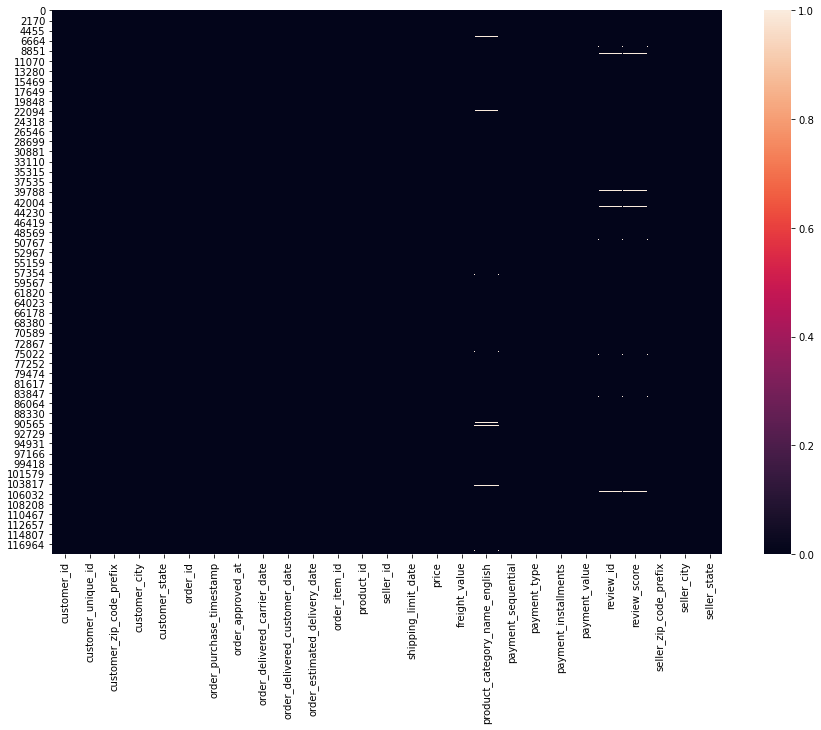

In [23]:
# ça nous permet de visualiser les valeurs manquantes en affichant tout le jeu de données
plt.figure(figsize = (15,10))
sns.heatmap(df_merged_nett1.isna())

In [24]:
# On supprimera les lignes qui comportent des valeurs manquantes
df_merged_nett2 = df_merged_nett1.dropna()
df_merged_nett2.shape

(94961, 27)

In [25]:
print(f"La taille du jeu de données après fusion : {df_merged.shape}")
print(f"La taille du jeu de données après l'application du premier filtre : {df_merged_filtre1.shape}")
print(f"La taille du jeu de données après l'application du deuxième filtre : {df_merged_filtre2.shape}")
print(f"La taille du jeu de données après la suppression des colonnes inutiles : {df_merged_nett1.shape}")
print(f"La taille du jeu de données après la suppression des valeurs manquantes : {df_merged_nett2.shape}")

La taille du jeu de données après fusion : (119143, 40)
La taille du jeu de données après l'application du premier filtre : (115723, 40)
La taille du jeu de données après l'application du deuxième filtre : (97007, 40)
La taille du jeu de données après la suppression des colonnes inutiles : (97007, 27)
La taille du jeu de données après la suppression des valeurs manquantes : (94961, 27)


On passe de 119143 lignes à 94961 lignes et de 40 colonnes à 27 colonnes.

### 5- Exploration 

In [26]:
# Séparer les variables en numériques et catégoriques
# Les variables numériques 
numerics = ['int16', 'int32', 'int64', 'float16', 'float32', 'float64']
var_num  = pd.DataFrame(df_merged_nett2.select_dtypes(include=numerics)).columns.tolist()

# Les variables catégoriques
cat = ['object','bool']
var_cat = pd.DataFrame(df_merged_nett2.select_dtypes(include=cat)).columns.tolist()

In [27]:
del var_num[0:2]
del var_num[-1]

In [28]:
var_num

['price',
 'freight_value',
 'payment_sequential',
 'payment_installments',
 'payment_value',
 'review_score']

#### (a) Analyse univariée

**Les variables numériques**

In [29]:
def hist_uni(data, x) :
    """Affiche l'histogramme de la variable x 
    arguments
    -------------------------
    data : DataFrame : jeu de données en entrée
    x : str : variable à visualiser """
    
    fig = px.histogram(data, x=x).update_xaxes(categoryorder = 'total descending')
    fig.show()

In [30]:
def boxplots_uni(data, x):
    """Affiche le boxplot de la variable x 
    arguments
    -------------------------
    data : DataFrame : jeu de données en entrée
    x : str : variable à visualiser """
    
    fig = px.box(data, x=x)
    fig.show()

In [31]:
# Pour les variables numériques
for var in var_num:
    hist_uni(df_merged_nett2, var)

In [32]:
# Pour les variables numériques
for var in var_num:
    boxplots_uni(df_merged_nett2, var)

**Interprétation graphique**

 - Pour la variable **price** : On voit bien qu'on a des outliers à partir de 6000
 
 - Pour la variable **freight_value** : On voit bien qu'on a des outliers à partir de 350
 
 - Pour la variable **payment_value** : On voit bien qu'on a des outliers à partir de 10k

#### (b) Les variables qualitatives

In [33]:
print("Les variables quantitatives :", var_cat)

Les variables quantitatives : ['customer_id', 'customer_unique_id', 'customer_city', 'customer_state', 'order_id', 'order_purchase_timestamp', 'order_approved_at', 'order_delivered_carrier_date', 'order_delivered_customer_date', 'order_estimated_delivery_date', 'product_id', 'seller_id', 'shipping_limit_date', 'product_category_name_english', 'payment_type', 'review_id', 'seller_city', 'seller_state']


On visualisera quelques variales qualitatives intéressantes

In [34]:
hist_uni(data=df_merged_nett2,x='order_purchase_timestamp')

On remarque qu'on n'a pas de données entre Octobre 2016 et janvier 2017

In [35]:
hist_uni(data=df_merged_nett2,x='product_category_name_english')

On remarque que les catégories des produits les plus achetés sont les produits immobiliers(table, lit, etc), sportifs.

<AxesSubplot:ylabel='payment_type'>

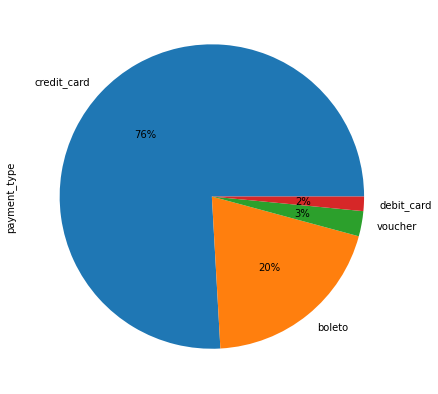

In [36]:
plt.figure(figsize=(10,7))
df_merged_nett2['payment_type'].value_counts().plot(kind='pie', autopct='%1.0f%%')

On a beaucoup de paiements par carte, et en deuxième position le paiment par billets (boleto). "voucher" est le paiment par des bons d'achats. Ainsi, le paiement par carte bancaire est le paiement le plus utilisé. 

### 2- Analyse bivariée

#### (a) Une variable numérique avec une variable catégorielle

In [37]:
def boxplots_bivariee(data,x,y):
    """Affiche le boxplot d'une variable x en fonction de y
    arguments
    -------------------------
    data : DataFrame : jeu de données en entrée
    x : str : variable en abscisse 
    y : str : variable en ordonnée"""
    plt.figure(figsize=(10,7))
    sns.boxplot(x=x, y=y,data=data)

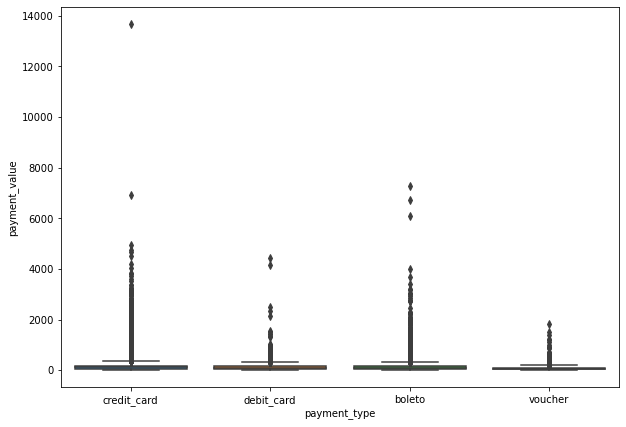

In [38]:
boxplots_bivariee(data=df_merged_nett2, x='payment_type', y='payment_value')

On remarque que pour le paiement par carte, on a des paiements plus élevés. 

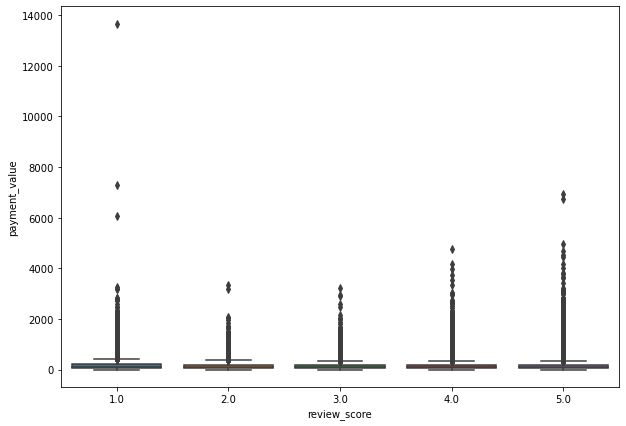

In [39]:
boxplots_bivariee(data=df_merged_nett2, x='review_score', y='payment_value')

#### (b) Une variable numérique avec une variable numérique

In [40]:
def nuage_points(data,x,y):
    """Affiche le nuage de points d'une variable x en fonction de y
    arguments
    -------------------------
    data : DataFrame : jeu de données en entrée
    x : str : variable en abscisse 
    y : str : variable en ordonnée"""
    fig = px.scatter(data_frame=data,x=x, y=y)
    fig.show()

In [41]:
var_num

['price',
 'freight_value',
 'payment_sequential',
 'payment_installments',
 'payment_value',
 'review_score']

In [42]:
nuage_points(df_merged_nett2, 'payment_value','price')

### 3- Analyse multivariée

**Corrélation**

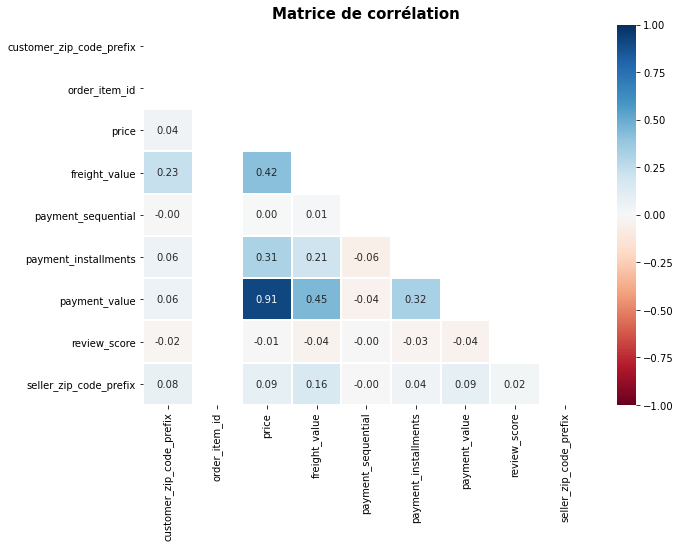

In [43]:
mask = np.triu(np.ones_like(df_merged_nett2.corr(), dtype=bool))

plt.figure(figsize=(10,7))
sns.heatmap(df_merged_nett2.corr(), mask=mask, center=0, cmap='RdBu', linewidths=1, annot=True, fmt='.2f', vmin=-1, vmax=1)

plt.title('Matrice de corrélation', fontsize=15, fontweight='bold')
plt.show()

### 6- Suppression des outliers

Pour les outliers, on n'opte pour la méthode de visualisation, on supprimera que les valeurs extrêmes vu auparavant sur les boxplots pour ne pas perdre les 3% des clients qui commandent le plus.

In [44]:
data_f = df_merged_nett2[(df_merged_nett2['payment_value'] <= 6000)]
data_f.shape

(94956, 27)

In [45]:
data_f.to_csv('C:/Users/admteliae/Desktop/Formatio_OC_temporaire/Projet 5/Data/data_nett_vf.csv',index = False)